---

# Customer Classification Project using Logistic Regression

---

---
# **Table of Contents**
---

**1.** [**Introduction**](#Section1)<br>

  - **1.1** [**Client Introduction.**](#Section2)  
  - **1.2** [**Current Scenario**](#Section3)
  

**2.** [**Problem Statement**](#Section4)<br>

  - **2.1** [**The Current Process Suffers From the Following Problems.**](#Section5)  
  - **2.2** [**Responsibilities**](#Section6)  
  - **2.3** [**Project Deliverables.**](#Section7)  
  - **2.4** [**Evaluation Metric**](#Section8)

**3.** [**Installing & Importing Libraries**](#Section9)<br>

  - **3.1** [**Installing Libraries**](#Section10)  
  - **3.2** [**Importing Libraries**](#Section11)

**4.** [**Data Acquisition & Description**](#Section12)<br>

  - **4.1** [**Loading Dataset**](#Section13)  
  - **4.2** [**Data Information**](#Section14)  
  - **4.3** [**Data Statistics**](#Section15)

**5.** [**Data Pre-processing**](#Section16)<br>

  - **5.1** [**Pre-Profiling Report**](#Section17)  
  - **5.2** [**Checking Duplicate Values**](#Section18)

**6.** [**Exploratory Data Analysis**](#Section19)<br>

  - **6.1** [**Customers in Grid-I and Grid-I**](#Section20)  
  - **6.2** [**Pair Plot on Variables**](#Section21)  
  - **6.3** [**Analyzing Customers based on Investment in Trading**](#Section22)  
  - **6.4** [**Analyzing Customers based on 'family_income'**](#Section23)  
  - **6.5** [**Analyzing Customers based on 'age_band**](#Section24)  
  - **6.6** [**Analyzing Customers based on 'home_status**](#Section25)  
  - **6.7** [**Analyzing Customers based on Employment status**](#Section26)  
  - **6.8** [**Heat Map**](#Section27)
  - **6.9** [**Scatter plot between Income vs Investment**](#Section28)

**7.** [**Data Preparation.**](#Section29)<br>

  - **7.1** [**Scaling the data**](#Section30)<br>  
  - **7.2** [**Extract Required Columns for Model Design**](#Section31)<br>  
  - **7.3** [**Scale features using RobustScalar**](#Section32)<br>  
  - **7.4** [**Preparing x and y using pandas**](#Section33)<br>
  - **7.5** [**Spliting X and y into train and test dataset**](#Section34)<br>
  - **7.6** [**Checking the shape of X and y of train dataset**](#Section35)<br>
  - **7.7** [**Checking the shape of X and y of test dataset**](#Section36)<br>
  
**8.** [**Model Development & Evaluation**](#Section37)<br>

  - **8.1** [**Building Logistic Regression Model**](#Section38)  
  - **8.2** [**Using Trained Model for Prediction**](#Section39)  
  - **8.3** [**Predicting y values using input x_test values**](#Section40)  
  - **8.4** [**Model Evaluation**](#Section41)  
  - **8.5** [**Checking Accuracy**](#Section42)  
  - **8.6** [**Checking Precision Score**](#Section43)  
  - **8.7** [**Checking Recall Score**](#Section44)  
  - **8.8** [**Checking F1-Score**](#Section45)
  

**9.** [**Conclusion**](#Section46)<br>

**10.** [**Generating Output file**](#Section47)<br>



---
<a name = Section1></a>
## **1. Introduction**
---
<a name = Section2></a>
### **1.1 Client Introduction**
- Client for this project is a retail banking institution.

- They are going to float a stock trading facility for their existing customers.
- The idea is to use data to classify whether a customer belongs to a high net worth or low net worth group.
- They will have to incentivize their customers to adopt their offerings.
- One way to incentivize is to offer discounts on the commission for trading transactions.

<center><img src="https://www.marketreview.com/wp-content/uploads/2019/09/retail-banks.jpg" width="480" height="100" /></center></br>

<a name = Section3></a>
### **1.2 Current Scenario**
- The company rolled out this service to about 10,000+ of its customers and observed their trading behavior for 6 months and after that, they labeled them into two revenue grids 1 and 2.

---
<a name = Section4></a>
## **2. Problem Statement**
---

 <a name = Section5></a>
### **2.1 The Current Process Suffers From the Following Problems**

- One issue is that only about 10% of the customers do enough trades for earnings after discounts to be profitable.
- The company wants to figure out, which are those 10% customers so that it can selectively offer them a discount.
- The marketing department has hired you as a data science consultant because they want to supplement their campaigns with a more proactive approach.

<a name = Section6></a>
### **2.2 Responsibilities**

- Dataset contains past customers details and their status (Revenue Grid 1 or 2).
- Task is to build a classification model using the datasets.
- build the best possible model.

<a name = Section7></a>
### **2.3 Project Deliverables**

- Predict whether a customer belongs to a high net worth or low net worth group.
- Machine Learning Task: Classification
- Target Variable: Status (high net worth (1) / low net worth (2))
- Win Condition: N/A (best possible model)

<a name = Section8></a>
### **2.4 Evaluation Metric**

- The model evaluation will be based on the F1 Score score.


---
<a name = Section9></a>
## **3.Installing & Importing Libraries**
---

<a name = Section10></a>
### **3.1 Installing Libraries**

In [1]:
!pip install -q datascience                   
!pip install -q pandas-profiling              

You should consider upgrading via the 'c:\users\dell\appdata\local\programs\python\python39\python.exe -m pip install --upgrade pip' command.
You should consider upgrading via the 'c:\users\dell\appdata\local\programs\python\python39\python.exe -m pip install --upgrade pip' command.


<a name = Section11></a>
### **3.2 Importing Libraries**

In [2]:
#-------------------------------------------------------------------------------------------------------------------------------
import pandas as pd                                                 # Importing for panel data analysis
from pandas_profiling import ProfileReport                          # Import Pandas Profiling (To generate Univariate Analysis) 
pd.set_option('display.max_columns', None)                          # Unfolding hidden features if the cardinality is high      
pd.set_option('display.max_colwidth', None)                         # Unfolding the max feature width for better clearity      
pd.set_option('display.max_rows', None)                             # Unfolding hidden data points if the cardinality is high
pd.set_option('mode.chained_assignment', None)                      # Removing restriction over chained assignments operations
pd.set_option('display.float_format', lambda x: '%.5f' % x)         # To suppress scientific notation over exponential values
#-------------------------------------------------------------------------------------------------------------------------------
import numpy as np                                                  # Importing package numpys (For Numerical Python)
from scipy.stats import randint as sp_randint                       # for initializing random integer values
#-------------------------------------------------------------------------------------------------------------------------------
import matplotlib.pyplot as plt                                     # Importing pyplot interface using matplotlib
from matplotlib.pylab import rcParams                               # Backend used for rendering and GUI integration                                               
import seaborn as sns                                               # Importin seaborm library for interactive visualization
%matplotlib inline
#-------------------------------------------------------------------------------------------------------------------------------
from sklearn.metrics import accuracy_score                          # For calculating the accuracy for the model
from sklearn.metrics import precision_score                         # For calculating the Precision of the model
from sklearn.metrics import recall_score                            # For calculating the recall of the model
from sklearn.metrics import precision_recall_curve                  # For precision and recall metric estimation
from sklearn.metrics import confusion_matrix                        # For verifying model performance using confusion matrix
from sklearn.metrics import f1_score                                # For Checking the F1-Score of our model  
from sklearn.metrics import roc_curve                               # For Roc-Auc metric estimation
#-------------------------------------------------------------------------------------------------------------------------------
from sklearn.model_selection import train_test_split                # To split the data in training and testing part     
from sklearn.ensemble import RandomForestClassifier                 # To create the RandomForest Model
from sklearn.model_selection import RandomizedSearchCV              # to create a RandomSearched hyper-tuned model
from sklearn.preprocessing import RobustScaler                      # to scale the data based on their inter-quartile range
from sklearn import linear_model
#-------------------------------------------------------------------------------------------------------------------------------
import warnings                                                     # Importing warning to disable runtime warnings
warnings.filterwarnings("ignore")                                   # Warnings will appear only once

---
<a name = Section12></a>
## **4. Data Acquisition & Description**
---

- dataset containing all the necessary information about the customers like their occupation, family    income, gender, region,   balance transfer, children, etc.

- Also included in the dataset is the column Revenue_Grid which classifies the customers into high net worth customers (1) and   low net worth customers (2).

- This is the data can be used to predict for future customers.

<a name = Section13></a>

### **4.1 Loading Dataset**

In [63]:
cust_df=pd.read_csv('https://raw.githubusercontent.com/niranjan1216/Machine_Learning_Foundation/main/CUSTOMER_CLASSIFICATION/existing_base_train.csv')

In [4]:
#cust_df=pd.read_csv(r'E:\PNK\Insaid\Project\ML Project-Customer Classification\existing_base_train.csv')

In [64]:
cust_df.head(10)

,REF_NO,children,age_band,status,occupation,occupation_partner,home_status,family_income,self_employed,self_employed_partner,year_last_moved,TVarea,post_code,post_area,Average_Credit_Card_Transaction,Balance_Transfer,Term_Deposit,Life_Insurance,Medical_Insurance,Average_A/C_Balance,Personal_Loan,Investment_in_Mutual_Fund,Investment_Tax_Saving_Bond,Home_Loan,Online_Purchase_Amount,gender,region,Investment_in_Commudity,Investment_in_Equity,Investment_in_Derivative,Portfolio_Balance,Revenue_Grid
0,5466,2,31-35,Partner,Professional,Professional,Own Home,">=35,000",No,No,1981,Meridian,M51 0GU,M51,26.98000,29.99000,312.25000,299.79000,88.72000,108.85000,175.43000,134.35000,8.98000,55.44000,7.68000,Female,North West,151.55000,81.79000,136.02000,360.37000,2
1,9091,Zero,45-50,Partner,Secretarial/Admin,Professional,Own Home,">=35,000",No,No,1997,Meridian,L40 2AG,L40,35.98000,74.48000,0.00000,99.96000,10.99000,48.45000,15.99000,0.00000,0.00000,0.00000,18.99000,Female,North West,44.28000,13.91000,29.23000,89.22000,2
2,9744,1,36-40,Partner,Manual Worker,Manual Worker,Rent Privately,"<22,500, >=20,000",Yes,Yes,1996,HTV,TA19 9PT,TA19,0.00000,24.46000,0.00000,18.44000,0.00000,0.00000,0.02000,10.46000,0.00000,0.00000,0.00000,Female,South West,8.58000,1.75000,4.82000,14.50000,2
3,10700,2,31-35,Partner,Manual Worker,Manual Worker,Own Home,"<25,000, >=22,500",No,No,1990,Scottish TV,FK2 9NG,FK2,44.99000,0.00000,0.00000,0.00000,29.99000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,Female,Scotland,15.00000,0.00000,5.00000,68.98000,2
4,1987,Zero,55-60,Partner,Housewife,Professional,Own Home,">=35,000",No,No,1989,Yorkshire,LS23 7DJ,LS23,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,9.98000,0.00000,0.00000,0.00000,Female,Unknown,0.00000,1.66000,1.66000,1.88000,2
5,3309,Zero,45-50,Partner,Secretarial/Admin,Business Manager,Own Home,">=35,000",No,No,1984,Ulster,BT17 9NA,BT17,9.49000,0.01000,0.00000,0.51000,55.89000,0.00000,28.98000,0.00000,0.00000,0.00000,0.00000,Female,Northern Ireland,13.18000,4.83000,14.23000,33.62000,2
6,6610,Zero,36-40,Partner,Secretarial/Admin,Secretarial/Admin,Own Home,"<30,000, >=27,500",Yes,No,1986,Central,B62 8TF,B62,9.99000,0.00000,0.00000,0.00000,0.00000,26.96000,22.99000,80.42000,1.00000,3.99000,5.49000,Female,West Midlands,2.00000,23.48000,21.90000,13.12000,2
7,10621,Zero,61-65,Partner,Retired,Retired,Own Home,"<20,000, >=17,500",No,No,1998,Granada,PR8 2TY,PR8,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,29.95000,0.00000,0.00000,0.00000,Male,North West,0.00000,4.99000,4.99000,15.74000,2
8,2630,1,45-50,Partner,Professional,Professional,Own Home,">=35,000",No,No,1980,Unknown,CF15 9TH,CF15,0.00000,82.96000,0.00000,40.47000,12.49000,0.00000,28.97000,0.00000,0.00000,0.00000,0.00000,Female,Unknown,27.18000,4.83000,13.66000,36.05000,2
9,9356,3,36-40,Partner,Professional,Housewife,Own Home,"<27,500, >=25,000",Yes,No,1997,Meridian,M13 9BG,M13,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,15.99000,0.00000,24.47000,0.00000,0.00000,Male,North West,0.00000,6.74000,6.74000,8.60000,2


In [61]:
cust_df.shape

(8124, 32)

In [62]:
cust_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8124 entries, 0 to 8123
Data columns (total 32 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   REF_NO                           8124 non-null   int64  
 1   children                         8124 non-null   object 
 2   age_band                         8124 non-null   object 
 3   status                           8124 non-null   object 
 4   occupation                       8124 non-null   object 
 5   occupation_partner               8124 non-null   object 
 6   home_status                      8124 non-null   object 
 7   family_income                    8124 non-null   object 
 8   self_employed                    8124 non-null   object 
 9   self_employed_partner            8124 non-null   object 
 10  year_last_moved                  8124 non-null   int64  
 11  TVarea                           8124 non-null   object 
 12  post_code           

<a name = Section14></a>

### **4.2 Data Information**

- In this section we will see the **information about the types of features**.

In [9]:
print("Shape of our Data is :", cust_df.shape)
print("Number of Rows are :",cust_df.shape[0])
print("Number of Columns are :",cust_df.shape[1])

Shape of our Data is : (8124, 32)
Number of Rows are : 8124
Number of Columns are : 32


**Observations:**

- Dataset contains **8124** rows, **32** columns.
- There are **no null values present**.
- Each feature seems to have **correct data type**.

<a name = Section15></a>

### **4.3 Data Statistics**

- In this section we will get **descriptive statistics of the data** and see some observations.

In [10]:
cust_df.describe()

,REF_NO,year_last_moved,Average_Credit_Card_Transaction,Balance_Transfer,Term_Deposit,Life_Insurance,Medical_Insurance,Average_A/C_Balance,Personal_Loan,Investment_in_Mutual_Fund,Investment_Tax_Saving_Bond,Home_Loan,Online_Purchase_Amount,Investment_in_Commudity,Investment_in_Equity,Investment_in_Derivative,Portfolio_Balance,Revenue_Grid
count,8124.00000,8124.00000,8124.00000,8124.00000,8124.00000,8124.00000,8124.00000,8124.00000,8124.00000,8124.00000,8124.00000,8124.00000,8124.00000,8124.00000,8124.00000,8124.00000,8124.00000,8124.00000
mean,5797.34330,1967.87691,23.25109,46.08292,27.28465,65.31794,18.82620,31.83802,25.41583,41.72363,6.05725,4.41691,19.19866,36.15275,21.44248,31.53065,89.35337,1.89414
std,3322.49757,182.56379,51.14750,79.08469,54.13354,95.76245,32.02233,45.24944,85.13015,64.41602,12.67337,9.94575,92.34313,42.47495,32.26166,39.48066,108.30354,0.30768
min,2.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,-78.43000,1.00000
25%,2924.75000,1978.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,8.28250,4.66000,8.74000,26.27750,2.00000
50%,5811.50000,1988.00000,0.00000,17.48500,0.00000,31.47500,0.01000,14.98000,0.00000,23.48000,0.00000,0.00000,0.00000,23.59000,12.82000,21.14000,65.56000,2.00000
75%,8681.50000,1994.00000,23.48000,64.99000,34.49000,92.88750,26.97000,45.92250,20.82750,59.44000,5.49000,4.49000,7.48000,49.79500,27.97250,42.39250,123.97000,2.00000
max,11518.00000,1999.00000,662.26000,2951.76000,784.82000,2930.41000,591.04000,626.24000,4905.93000,2561.27000,156.87000,162.35000,4306.42000,1231.09000,1279.10000,1771.16000,4283.56000,2.00000


**Observations:**

- **61%**(**4989** out of **8124**) of customers are not using Credit_Card.Their **Average_Credit_Card_Transaction** is **0.0**
- **4587** Customers out of **8124**(more than **50%**)  are having **Term_Deposit** value **0.0**.
- Some columns are having outliers.
- 4078 Customers not having **Medical_Insurance**.
- **63%** Customers are not having **Personal_Loan**.
- **63%** Customers are not having **Investment_Tax_Saving_Bond**.
- **69%** Customers are not having **Home_Loan**.
- **5700** customers are not interested online Purchase.

---
<a name = Section16></a>

# **5. Data Pre-Processing**
---

<a name = Section17></a>
### **5.1 Pre-Profiling Report**

- For **quick analysis** pandas profiling is very handy.

- Generates profile reports from a pandas DataFrame.

- For each column **statistics** are presented in an interactive HTML report.

In [11]:
cust_df.profile_report()

Summarize dataset:   0%|          | 0/45 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<a name = Section18></a>

### **5.2 Checking Duplicate Values**

In [12]:
duplicates = cust_df[cust_df.duplicated()]
duplicates

,REF_NO,children,age_band,status,occupation,occupation_partner,home_status,family_income,self_employed,self_employed_partner,year_last_moved,TVarea,post_code,post_area,Average_Credit_Card_Transaction,Balance_Transfer,Term_Deposit,Life_Insurance,Medical_Insurance,Average_A/C_Balance,Personal_Loan,Investment_in_Mutual_Fund,Investment_Tax_Saving_Bond,Home_Loan,Online_Purchase_Amount,gender,region,Investment_in_Commudity,Investment_in_Equity,Investment_in_Derivative,Portfolio_Balance,Revenue_Grid


**Observations:**
- Report show that there are **32 features** out of which **17 are numerical** ,**13 are Categorical** and **2 are boolean**.

- There is **no missing data**.

- There are **no duplicate** rows .

In [13]:
# reset index as 'REF_NO'
cust_df.set_index('REF_NO',inplace=True)

In [14]:
#In childrem Column "Zero" is replaced with '0'
cust_df.loc[(cust_df.children == 'Zero'),'children']='0'

In [15]:
cust_df.head(10)

,children,age_band,status,occupation,occupation_partner,home_status,family_income,self_employed,self_employed_partner,year_last_moved,TVarea,post_code,post_area,Average_Credit_Card_Transaction,Balance_Transfer,Term_Deposit,Life_Insurance,Medical_Insurance,Average_A/C_Balance,Personal_Loan,Investment_in_Mutual_Fund,Investment_Tax_Saving_Bond,Home_Loan,Online_Purchase_Amount,gender,region,Investment_in_Commudity,Investment_in_Equity,Investment_in_Derivative,Portfolio_Balance,Revenue_Grid
REF_NO,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
5466,2,31-35,Partner,Professional,Professional,Own Home,">=35,000",No,No,1981,Meridian,M51 0GU,M51,26.98000,29.99000,312.25000,299.79000,88.72000,108.85000,175.43000,134.35000,8.98000,55.44000,7.68000,Female,North West,151.55000,81.79000,136.02000,360.37000,2
9091,0,45-50,Partner,Secretarial/Admin,Professional,Own Home,">=35,000",No,No,1997,Meridian,L40 2AG,L40,35.98000,74.48000,0.00000,99.96000,10.99000,48.45000,15.99000,0.00000,0.00000,0.00000,18.99000,Female,North West,44.28000,13.91000,29.23000,89.22000,2
9744,1,36-40,Partner,Manual Worker,Manual Worker,Rent Privately,"<22,500, >=20,000",Yes,Yes,1996,HTV,TA19 9PT,TA19,0.00000,24.46000,0.00000,18.44000,0.00000,0.00000,0.02000,10.46000,0.00000,0.00000,0.00000,Female,South West,8.58000,1.75000,4.82000,14.50000,2
10700,2,31-35,Partner,Manual Worker,Manual Worker,Own Home,"<25,000, >=22,500",No,No,1990,Scottish TV,FK2 9NG,FK2,44.99000,0.00000,0.00000,0.00000,29.99000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,Female,Scotland,15.00000,0.00000,5.00000,68.98000,2
1987,0,55-60,Partner,Housewife,Professional,Own Home,">=35,000",No,No,1989,Yorkshire,LS23 7DJ,LS23,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,9.98000,0.00000,0.00000,0.00000,Female,Unknown,0.00000,1.66000,1.66000,1.88000,2
3309,0,45-50,Partner,Secretarial/Admin,Business Manager,Own Home,">=35,000",No,No,1984,Ulster,BT17 9NA,BT17,9.49000,0.01000,0.00000,0.51000,55.89000,0.00000,28.98000,0.00000,0.00000,0.00000,0.00000,Female,Northern Ireland,13.18000,4.83000,14.23000,33.62000,2
6610,0,36-40,Partner,Secretarial/Admin,Secretarial/Admin,Own Home,"<30,000, >=27,500",Yes,No,1986,Central,B62 8TF,B62,9.99000,0.00000,0.00000,0.00000,0.00000,26.96000,22.99000,80.42000,1.00000,3.99000,5.49000,Female,West Midlands,2.00000,23.48000,21.90000,13.12000,2
10621,0,61-65,Partner,Retired,Retired,Own Home,"<20,000, >=17,500",No,No,1998,Granada,PR8 2TY,PR8,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,29.95000,0.00000,0.00000,0.00000,Male,North West,0.00000,4.99000,4.99000,15.74000,2
2630,1,45-50,Partner,Professional,Professional,Own Home,">=35,000",No,No,1980,Unknown,CF15 9TH,CF15,0.00000,82.96000,0.00000,40.47000,12.49000,0.00000,28.97000,0.00000,0.00000,0.00000,0.00000,Female,Unknown,27.18000,4.83000,13.66000,36.05000,2


---
<a name = Section19></a>

# **6. Exploratory Data Analysis**
---

<a name = Section20></a>

### **6.1 Number of Customers in Grid-I and Grid-II**

In [16]:
g1=cust_df[cust_df['Revenue_Grid']==1].index
g2=cust_df[cust_df['Revenue_Grid']==2].index
print("Number of Customers in Grid-I:",len(g1))
print("Number of Customers in Grid-II:",len(g2))

Number of Customers in Grid-I: 860
Number of Customers in Grid-II: 7264


**Observations:**
- 10% of customers are classified to Grid-I

<a name = Section21></a>
### **6.2 Pair Plot on Variables**

Text(0.5, 1.0, 'Pair Plot')

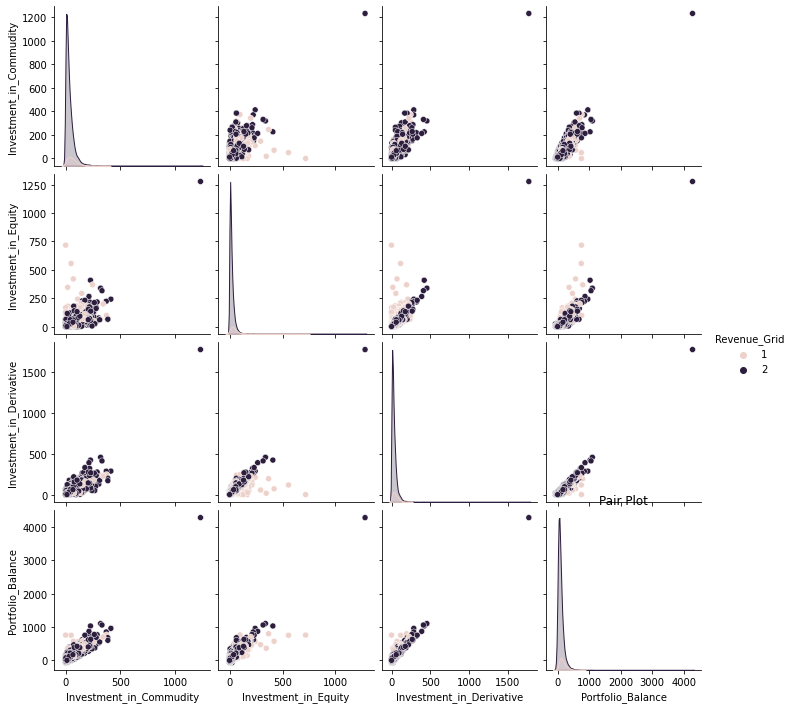

In [17]:
#Pair Plot Describes relation between variables 'Investment_in_Commudity','Investment_in_Equity','Investment_in_Derivative','Portfolio_Balance','Revenue_Grid'
sns.pairplot(cust_df[['Investment_in_Commudity','Investment_in_Equity','Investment_in_Derivative','Portfolio_Balance','Revenue_Grid']],vars=['Investment_in_Commudity','Investment_in_Equity','Investment_in_Derivative','Portfolio_Balance'],hue='Revenue_Grid')
plt.title('Pair Plot')

<a name = Section22></a>
### **6.3 Analyzing Customers based on Investment in Trading**

In [18]:
c1=cust_df.copy()
c1['Invetstment_Trading']=c1['Investment_in_Commudity']+c1['Investment_in_Equity']+c1['Investment_in_Derivative']

In [19]:
c1[c1['Revenue_Grid']==1]['Invetstment_Trading'].describe()

count   860.00000
mean    155.40709
std     113.41397
min      12.50000
25%      77.72000
50%     127.74500
75%     204.77250
max     807.69000
Name: Invetstment_Trading, dtype: float64

In [20]:
# IQR Count for 'Revenue_Grid-1'
k=c1[c1['Revenue_Grid']==1]
q1=k[k['Invetstment_Trading']<12.5].index
q2=k[k['Invetstment_Trading']<=205.0].index
c=len(q2)-len(q1)
print(c)

646


In [21]:
c1[c1['Revenue_Grid']==2]['Invetstment_Trading'].describe()

count   7264.00000
mean      81.27871
std      100.30730
min        0.00000
25%       24.45750
50%       55.49000
75%      106.31250
max     4281.35000
Name: Invetstment_Trading, dtype: float64

In [22]:
# IQR Count for 'Revenue_Grid-1'
k=c1[c1['Revenue_Grid']==2]
q3=k[k['Invetstment_Trading']<24.0].index
q4=k[k['Invetstment_Trading']<=200.0].index
c=len(q4)-len(q3)
print(c)

4907


**Observations:**
- Most of customers in **Revenue_Grid-1** are invested in the range from **12.5** to **204**.
- Most of customers in **Revenue_Grid-2** are invested in the range from **24** to **106**.
- Average Investment of customers in **Revenue_Grid-1** is **155**.
- Average Investment of customers in **Revenue_Grid-2** is **81**.

<a name = Section23></a>
### **6.4 Which catagory of customer(group by 'family_income') most invested in trading**

In [23]:
cf_df=c1.groupby('family_income').mean()
cf_df[cf_df['Invetstment_Trading']==cf_df['Invetstment_Trading'].max()]

,year_last_moved,Average_Credit_Card_Transaction,Balance_Transfer,Term_Deposit,Life_Insurance,Medical_Insurance,Average_A/C_Balance,Personal_Loan,Investment_in_Mutual_Fund,Investment_Tax_Saving_Bond,Home_Loan,Online_Purchase_Amount,Investment_in_Commudity,Investment_in_Equity,Investment_in_Derivative,Portfolio_Balance,Revenue_Grid,Invetstment_Trading
family_income,,,,,,,,,,,,,,,,,,
">=35,000",1981.59930,25.75978,49.90277,29.24973,69.97040,20.25460,33.50631,38.11575,45.00352,6.84942,4.60748,23.59727,39.02758,25.28069,35.61756,99.93300,1.88878,99.92583


**Observaions:**
- customers having **family income >= 35000** are invested more in trading.

<a name = Section24></a>
### **6.5 Which catagory of customers(group by 'age_band') most invested in trading**

In [24]:
cf_df=c1.groupby('age_band').mean()
cf_df[cf_df['Invetstment_Trading']==cf_df['Invetstment_Trading'].max()]

,year_last_moved,Average_Credit_Card_Transaction,Balance_Transfer,Term_Deposit,Life_Insurance,Medical_Insurance,Average_A/C_Balance,Personal_Loan,Investment_in_Mutual_Fund,Investment_Tax_Saving_Bond,Home_Loan,Online_Purchase_Amount,Investment_in_Commudity,Investment_in_Equity,Investment_in_Derivative,Portfolio_Balance,Revenue_Grid,Invetstment_Trading
age_band,,,,,,,,,,,,,,,,,,
18-21,1989.40000,37.26120,61.73500,37.63860,93.66340,27.14420,31.25080,31.90580,46.05460,7.40540,3.41760,28.16620,51.48900,24.70040,39.57140,121.27100,1.84000,115.76080


**Observaions:**
- Customers in the **age_band 18-21**  are invested more in trading.

<a name = Section25></a>
### **6.6 Which catagory of customer(group by 'home_status') most invested in trading**

In [25]:
c1['home_status'].value_counts()

Own Home                7506
Rent from Council/HA     279
Rent Privately           205
Live in Parental Hom      90
Unclassified              44
Name: home_status, dtype: int64

In [26]:
cf_df2=c1.groupby('home_status').mean()
#print(len(cf_df2.index))
cf_df2[cf_df2['Invetstment_Trading']==cf_df2['Invetstment_Trading'].max()]

,year_last_moved,Average_Credit_Card_Transaction,Balance_Transfer,Term_Deposit,Life_Insurance,Medical_Insurance,Average_A/C_Balance,Personal_Loan,Investment_in_Mutual_Fund,Investment_Tax_Saving_Bond,Home_Loan,Online_Purchase_Amount,Investment_in_Commudity,Investment_in_Equity,Investment_in_Derivative,Portfolio_Balance,Revenue_Grid,Invetstment_Trading
home_status,,,,,,,,,,,,,,,,,,
Rent from Council/HA,1976.75627,24.73527,50.79652,28.26907,67.45179,18.09376,33.93599,16.89448,43.60470,6.40165,4.56151,20.02728,37.86921,20.90527,31.06427,89.21796,1.87455,89.83875


**Observaions:**
- Customers having **home_status** as **Rent from Council/HA**  are invested more in trading.

<a name = Section26></a>
### **6.7 Which catagory of customer(group by 'self_employed') most invested in trading**

In [27]:
cf_df=c1.groupby('self_employed').mean()
cf_df=cf_df.reset_index()
cf_df[cf_df['Invetstment_Trading']==cf_df['Invetstment_Trading'].max()]
cf_df

,self_employed,year_last_moved,Average_Credit_Card_Transaction,Balance_Transfer,Term_Deposit,Life_Insurance,Medical_Insurance,Average_A/C_Balance,Personal_Loan,Investment_in_Mutual_Fund,Investment_Tax_Saving_Bond,Home_Loan,Online_Purchase_Amount,Investment_in_Commudity,Investment_in_Equity,Investment_in_Derivative,Portfolio_Balance,Revenue_Grid,Invetstment_Trading
0,No,1967.26501,23.30874,45.82460,27.45457,64.86152,18.86288,31.79418,24.95610,41.76160,6.04370,4.36271,19.32207,36.06264,21.37416,31.38084,89.04358,1.89460,88.81764
1,Yes,1975.82100,22.50275,49.43670,25.07861,71.24360,18.34986,32.40725,31.38439,41.23060,6.23312,5.12060,17.59637,37.32262,22.32941,33.47565,93.37522,1.88812,93.12768


In [28]:
c1['self_employed'].value_counts()

No     7543
Yes     581
Name: self_employed, dtype: int64

**Observaions:**
- **Self Employed customers** are more active in trading. 

<a name = Section27></a>
### **6.8 Heat Map**

<AxesSubplot:>

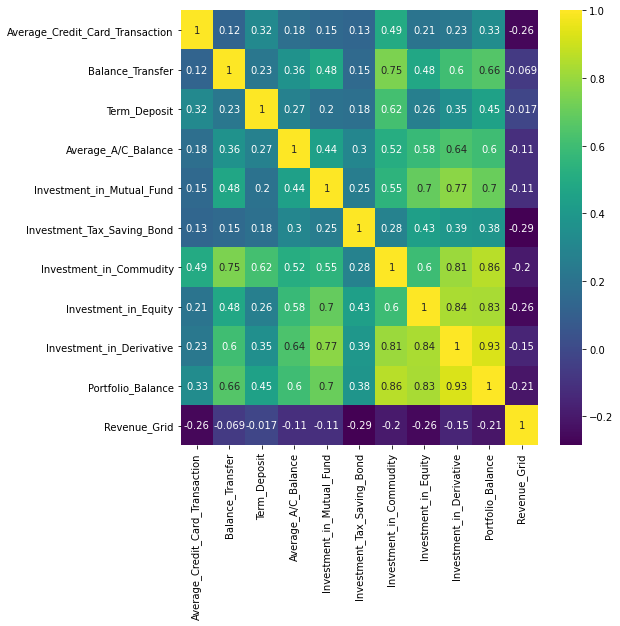

In [29]:
cust_df2=cust_df[['Average_Credit_Card_Transaction','Balance_Transfer','Term_Deposit','Average_A/C_Balance','Investment_in_Mutual_Fund',
       'Investment_Tax_Saving_Bond','Investment_in_Commudity','Investment_in_Equity','Investment_in_Derivative','Portfolio_Balance','Revenue_Grid']]
corr_mat=cust_df2.corr()
plt.figure(figsize=(8,8))
sns.heatmap(corr_mat,annot=True,cmap='viridis')

**Observations:**
- Strong correlation between **'Portfolio_Balance'**and **'Investment_in_Commudity','Investment_in_Equity','Investment_in_Derivative'**
- **Revenue_Grid** column having week correlation with other columns   

<a name = Section28></a>
### **6.9 Scatter plot between Income vs Investment** 

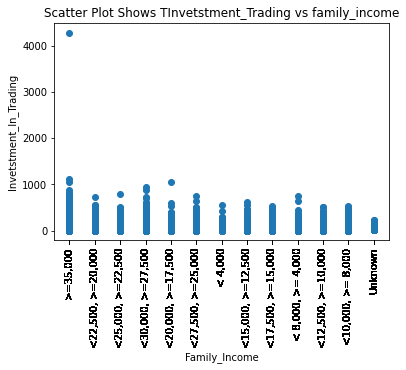

In [30]:
plt.scatter(c1['family_income'],c1['Invetstment_Trading'])
plt.xticks(c1['family_income'],rotation ='vertical')
plt.title("Scatter Plot Shows TInvetstment_Trading vs family_income")
plt.ylabel("Invetstment_In_Trading")
plt.xlabel('Family_Income')
plt.show()

**Observations:**
- Customers having more income are invested more in trading.

---
<a name = Section29></a>
# **7.Data Preparation**
---

<a name = Section30></a>
### **7.1 Scaling the data**

- We will use **RobustScalar** to **scale features** of our data.

- __RobustScalar__ is similar to normalization but it instead **uses the interquartile range, so that it is robust to outliers**.

- Please refer to the link of RobustScalar - http://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.RobustScaler.html

<a name = Section31></a>
### **7.2 Extract Required Columns for Model Design**

In [32]:
cust2_df=cust_df[['Average_Credit_Card_Transaction','Balance_Transfer','Term_Deposit','Life_Insurance','Medical_Insurance','Average_A/C_Balance','Personal_Loan','Investment_in_Mutual_Fund','Investment_Tax_Saving_Bond','Home_Loan','Online_Purchase_Amount','Investment_in_Commudity','Investment_in_Equity','Investment_in_Derivative','Portfolio_Balance','Revenue_Grid']]
cust2_df.shape

(8124, 16)

<a name = Section32></a>
### **7.3 Scale features using RobustScalar**

- RobustScaler is less prone to outliers.

In [33]:
rob_scaler = RobustScaler()
cust2_df['S_Average_Credit_Card_Transaction'] = rob_scaler.fit_transform(cust2_df['Average_Credit_Card_Transaction'].values.reshape(-1,1))
cust2_df['S_Balance_Transfer'] = rob_scaler.fit_transform(cust2_df['Balance_Transfer'].values.reshape(-1,1))
cust2_df['S_Term_Deposit'] = rob_scaler.fit_transform(cust2_df['Term_Deposit'].values.reshape(-1,1))
cust2_df['S_Life_Insurance'] = rob_scaler.fit_transform(cust2_df['Life_Insurance'].values.reshape(-1,1))
cust2_df['S_Medical_Insurance'] = rob_scaler.fit_transform(cust2_df['Medical_Insurance'].values.reshape(-1,1))
cust2_df['S_Average_A/C_Balance'] = rob_scaler.fit_transform(cust2_df['Average_A/C_Balance'].values.reshape(-1,1))
cust2_df['S_Personal_Loan'] = rob_scaler.fit_transform(cust2_df['Personal_Loan'].values.reshape(-1,1))
cust2_df['S_Investment_in_Mutual_Fund'] = rob_scaler.fit_transform(cust2_df['Investment_in_Mutual_Fund'].values.reshape(-1,1))
cust2_df['S_Investment_Tax_Saving_Bond'] = rob_scaler.fit_transform(cust2_df['Investment_Tax_Saving_Bond'].values.reshape(-1,1))
cust2_df['S_Home_Loan'] = rob_scaler.fit_transform(cust2_df['Home_Loan'].values.reshape(-1,1))
cust2_df['S_Online_Purchase_Amount'] = rob_scaler.fit_transform(cust2_df['Online_Purchase_Amount'].values.reshape(-1,1))
cust2_df['S_Investment_in_Commudity'] = rob_scaler.fit_transform(cust2_df['Investment_in_Commudity'].values.reshape(-1,1))
cust2_df['S_Investment_in_Equity'] = rob_scaler.fit_transform(cust2_df['Investment_in_Equity'].values.reshape(-1,1))
cust2_df['S_Investment_in_Derivative'] = rob_scaler.fit_transform(cust2_df['Investment_in_Derivative'].values.reshape(-1,1))
cust2_df['S_Portfolio_Balance'] = rob_scaler.fit_transform(cust2_df['Portfolio_Balance'].values.reshape(-1,1))
cust2_df.drop(['Average_Credit_Card_Transaction','Balance_Transfer','Term_Deposit','Life_Insurance','Medical_Insurance','Average_A/C_Balance','Personal_Loan','Investment_in_Mutual_Fund','Investment_Tax_Saving_Bond','Home_Loan','Online_Purchase_Amount','Investment_in_Commudity','Investment_in_Equity','Investment_in_Derivative','Portfolio_Balance'],axis=1,inplace=True)


In [35]:
cust2_df.shape

(8124, 16)

In [36]:
cust2_df.head(5)

,Revenue_Grid,S_Average_Credit_Card_Transaction,S_Balance_Transfer,S_Term_Deposit,S_Life_Insurance,S_Medical_Insurance,S_Average_A/C_Balance,S_Personal_Loan,S_Investment_in_Mutual_Fund,S_Investment_Tax_Saving_Bond,S_Home_Loan,S_Online_Purchase_Amount,S_Investment_in_Commudity,S_Investment_in_Equity,S_Investment_in_Derivative,S_Portfolio_Balance
REF_NO,,,,,,,,,,,,,,,,
5466,2,1.14906,0.19241,9.05335,2.88860,3.28921,2.04410,8.42300,1.86524,1.63570,12.34744,1.02674,3.08245,2.95850,3.41371,3.01773
9091,2,1.53237,0.87698,0.00000,0.73729,0.40712,0.72884,0.76773,-0.39502,0.00000,0.00000,2.53877,0.49840,0.04676,0.24040,0.24219
9744,2,0.00000,0.10732,0.00000,-0.14033,-0.00037,-0.32620,0.00096,-0.21904,0.00000,0.00000,0.00000,-0.36158,-0.47485,-0.48496,-0.52266
10700,2,1.91610,-0.26904,0.00000,-0.33885,1.11161,-0.32620,0.00000,-0.39502,0.00000,0.00000,0.00000,-0.20693,-0.54992,-0.47961,0.03501
1987,2,0.00000,-0.26904,0.00000,-0.33885,-0.00037,-0.32620,0.00000,-0.22712,0.00000,0.00000,0.00000,-0.56826,-0.47871,-0.57886,-0.65184


<a name = Section33></a>
### **7.4 Preparing x and y using pandas**

In [37]:
x = cust2_df.drop(['Revenue_Grid'],axis = 1)
y = cust2_df['Revenue_Grid']

<a name = Section34></a>
### **7.5 Spliting X and y into train and test dataset.**

In [38]:
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.25, random_state=1)

<a name = Section35></a>
### **7.6 Checking the shape of X and y of train dataset**

In [39]:
print(X_train.shape)
print(y_train.shape)

(6093, 15)
(6093,)


<a name = Section36></a>
### **7.7 Checking the shape of X and y of test dataset**

In [40]:
print(X_test.shape)
print(y_test.shape)

(2031, 15)
(2031,)


---
<a name = Section37></a>
# **8. Model Development & Evaluation**
---

- In this section we will **develop Logistic Regression model** .

- Then we will **analyze the results** obtained.

- For **evaluation purpose** we will **focus** on **Precision**, also we will check for **Accuracy**, **Recall score**, **F1-Score**.


<a name = Section38></a>
### **8.1 Building Logistic Regression Model**

In [41]:
cust_model = linear_model.LogisticRegression()
cust_model.fit(X_train, y_train)

LogisticRegression()

<a name = Section39></a>
### **8.2 Using Trained Model for Prediction**

<a name = Section40></a>
### **8.3 Predicting y values using input x_test values**

In [42]:
y_pred = cust_model.predict(X_test)

<a name = Section41></a>
### **8.4 Model Evaluation**

<a name = Section42></a>
### 8.5 Checking Accuracy

In [43]:
from sklearn import metrics
print("Accuracy of Logistic Regression model is:",
metrics.accuracy_score(y_test, y_pred)*100)

Accuracy of Logistic Regression model is: 93.50073855243723


<a name = Section43></a>
### 8.6 Checking Precision Score

In [44]:
print("Precision:")
precision_score(y_test,y_pred)

Precision:


0.8125

<a name = Section44></a>
### 8.7 Checking Recall Score

In [45]:
print("Recall:")
recall_score(y_test,y_pred)

Recall:


0.5909090909090909

<a name = Section45></a>
### 8.8 Checking F1-Score

- The F measure (F1 score or F score) is a **measure of a test’s accuracy** and is defined as **the weighted harmonic mean of the precision and recall of the test**.
- The F score can **provide a more realistic measure of a test’s performance** by **using both precision and recall**. 
- The F score is often **used in information retrieval** for measuring search, **document classification**, and **query classification performance**.

<center><img src="https://raw.githubusercontent.com/insaid2018/Term-2/master/images/f1.jpg" width="300" height="240" /></center>


In [46]:
f1_score(y_test,y_pred)

0.6842105263157896

- Our objective is to minimize **False Positive** so that customer belongs to low net worth group should not predicted as high net worth group. Therefore, among **recall & precision scores**, we will give more importance to **precision score**.


- **Precision score**  for above model is: **0.8125**.

---
<a name = Section46></a>
# **9. Conclusion**
---

- Studied various **features** of the given customer dataset,its **characteristics** and **distribution**.

- Investigated indepth about the features which to **retain** and which to **discard**.

- **Exploratory Data analysis** helps in finding correlation among features.

- customers having more income are invested more in trading.

- Average Investment of customers in **Revenue_Grid-1** is **155**.

- Average Investment of customers in **Revenue_Grid-2** is **81**

- Highest average Investment in Trading from Customers in the age_band 18-21. 

- **Self Employed customers** are more active in trading.

- Performed **model building**.

- Computed **metrics** for our prediction.

- This **model** now can **help us** in **identifying** the  **high net worth customer**.

<a name = Section47></a>
# 10.Generating **"Output"** file  

In [47]:
result=X_test.copy()
result=result.reset_index()
result_df=pd.DataFrame(result['REF_NO'])
result_df['Revenue_Grid']=y_pred
result_df
result_df.to_csv('submission.csv', index=False, header=False)